# House sales price regression modeling

## Python library and houses data import

In [1]:
# Import necessary libraries
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
from plotly.subplots import make_subplots
import plotly.graph_objects as go

from scipy import stats
import statsmodels.api as sm
import statsmodels.formula.api as smf

# Display figures as svg in notebook (improves resolution)
#from IPython.display import set_matplotlib_formats
#set_matplotlib_formats('svg')

# Import the data
houses = pd.read_csv("../data/King_County_House_prices_dataset.csv") # ../ jumps up one level in the directory

## Additional variables

In [2]:
# Relabel waterfront = NA as not on waterfront
houses["waterfront"] = houses["waterfront"].fillna(2)
houses["waterfront_cat"] = houses.waterfront.astype(str)
houses.waterfront_cat.replace("waterfront unknown","not on waterfront", inplace=True)
houses.waterfront.replace(2,0, inplace=True)

# Houses with yr_renovated = NAN are treated as if they were never renovated
houses["yr_renovated"] = houses["yr_renovated"].fillna(0)

# Categorical variable renovated y/n
# houses["renovated_cat"] = houses.yr_renovated>0
houses["renovated_cat"] = houses.yr_renovated
houses.renovated_cat[houses["yr_renovated"]>0] = 1

# When was the last time work was done on the house (either built or renovated)
houses["yr_lastrenewal"] = np.where(houses["yr_renovated"] > 0, houses["yr_renovated"], houses["yr_built"])

/var/folders/53/gg42r53n4gqf4gxqzfcm5gcm0000gn/T/ipykernel_955/190633721.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  houses.renovated_cat[houses["yr_renovated"]>0] = 1


## Correlation matrix to identify candidate sales price predictors

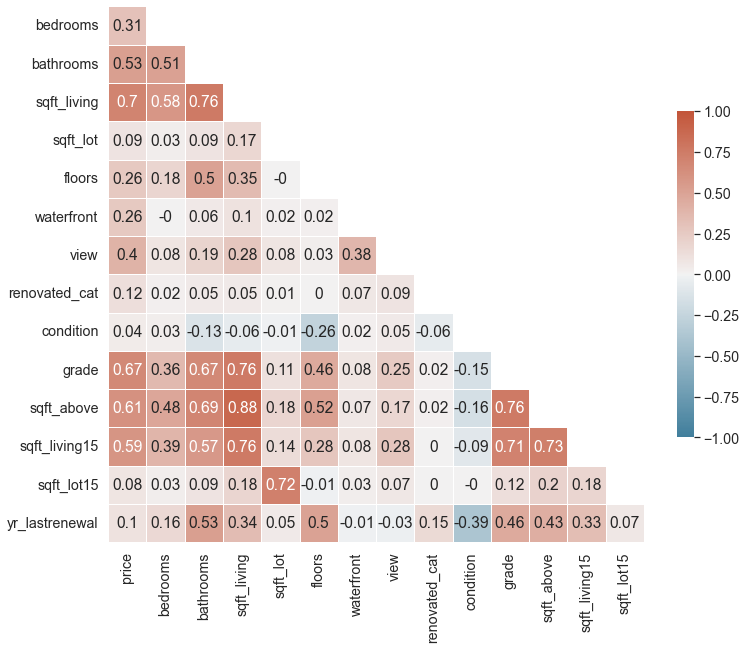

In [3]:
houses_sub = houses[['price','bedrooms','bathrooms','sqft_living','sqft_lot','floors','waterfront','view','renovated_cat',
                     'condition','grade','sqft_above','sqft_basement','sqft_living15','sqft_lot15','yr_lastrenewal']]

# Compute the correlation matrix
corr = houses_sub.corr().round(2)

# Generate a mask for the upper triangle
mask = np.triu(np.ones_like(corr, dtype=bool))

# To not display the self-correlated cells, adjust mask and corr
mask = mask[1:, :-1]
corr = corr.iloc[1:,:-1].copy()

sns.set_theme(style="white")

# Generate a custom diverging colormap
cmap = sns.diverging_palette(230, 20, as_cmap=True)

# Draw the heatmap with the mask and correct aspect ratio
sns.set(style="whitegrid", rc={'figure.figsize':(12,12)}, font_scale=1.3)
sns_plot = sns.heatmap(corr, mask=mask, cmap=cmap, vmin=-1, vmax=1, center=0,
                square=True, annot=True, linewidths=.5, cbar_kws={"shrink": .5})
#plt.show()
plt.savefig("../figures/corr_matrix.png", dpi=300)

## Candidate predictors selection

In [4]:
# Sort correlation matrix to obtain list of candidate predictors in descending order of correlation with price
corr.sort_values("price", ascending=False, inplace=True)
candidate_preds = corr[corr["price"] >= 0.3].index.tolist()

# Add waterfront and renovated_cat to candidate predictors (in stakeholder search profile) regardless of correlation cutoff
candidate_preds.append("waterfront")
candidate_preds.append("renovated_cat")
candidate_preds.append("price")

# Remove duplicates if above code inserted waterfront and renovated_cat twice
candidate_preds = list(dict.fromkeys(candidate_preds))

# Remove variables not needed
houses_sub = houses[candidate_preds]

## Outlier removal

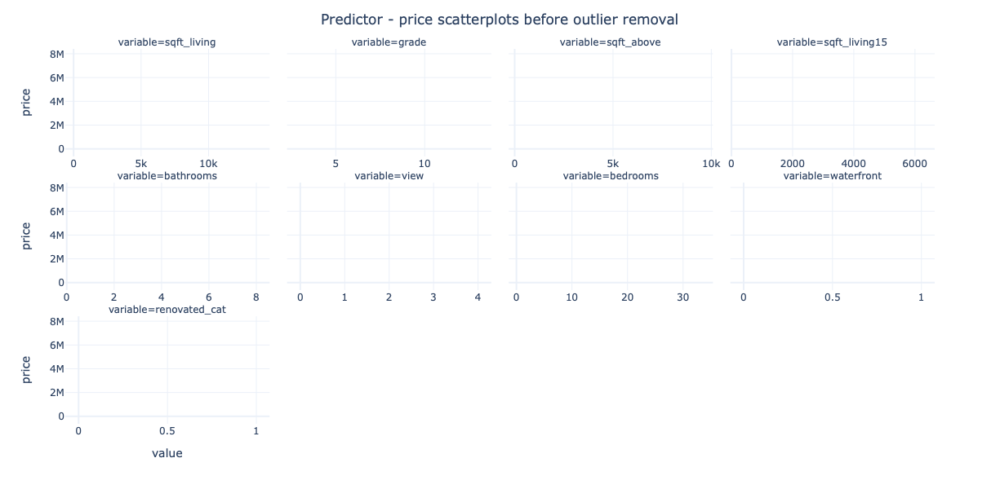

/var/folders/53/gg42r53n4gqf4gxqzfcm5gcm0000gn/T/ipykernel_955/4265855853.py:25: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



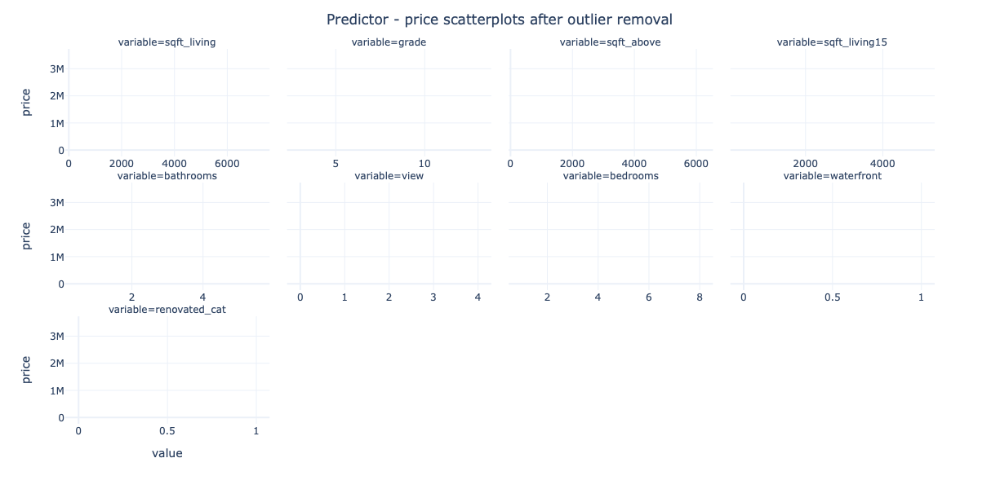

In [5]:
show_figs = True

# price ~ predictor scatter plots prior to outlier removal
if show_figs is True:
    houses_sub2 = pd.melt(houses_sub, id_vars="price", value_vars=candidate_preds)
    fig = px.scatter(houses_sub2, x="value", y="price", facet_col='variable', facet_col_wrap=4)
    fig.update_xaxes(matches=None)
    fig.for_each_xaxis(lambda xaxis: xaxis.update(showticklabels=True))
    fig.update_layout(autosize=False,width=1000,height=600,template="plotly_white",
                      title="Predictor - price scatterplots before outlier removal", title_x=0.5)
    fig.show()
    fig.write_image("../figures/scatter_with_outliers.png",scale=5)

    
# Outlier identification not for variables with pre-defined value range (i.e., grade and view) or categorical variables (waterfront, renovated y/n)
pred_outlier_rm = candidate_preds[:] # copy list with [:] because otherwise we only create a pointer and modify the original list together with its "copy"
pred_outlier_rm.remove("grade")
pred_outlier_rm.remove("view")
pred_outlier_rm.remove("waterfront")
pred_outlier_rm.remove("renovated_cat")

# For each variable, identify values exceeding the quantile set below
# (separate from actual removal below to avoid outliers in variable B being contingent on already performed removal on variable A)
for pred in pred_outlier_rm:
    houses_sub[pred + "_is_outlier"] = houses_sub[pred] > houses_sub[pred].quantile(0.999) # throws warning but still works

# Actual outlier removal   
for pred in pred_outlier_rm:
    houses_sub = houses_sub[houses_sub[pred + "_is_outlier"]==False]
    houses_sub = houses_sub.drop(columns=[pred + "_is_outlier"])
    
    
# price ~ predictor scatter plots after outlier removal
if show_figs is True:
    houses_sub2 = pd.melt(houses_sub, id_vars="price", value_vars=candidate_preds)
    fig = px.scatter(houses_sub2, x="value", y="price", facet_col='variable', facet_col_wrap=4)
    fig.update_xaxes(matches=None)
    fig.for_each_xaxis(lambda xaxis: xaxis.update(showticklabels=True))
    fig.update_layout(autosize=False,width=1000,height=600,template="plotly_white",
                      title="Predictor - price scatterplots after outlier removal", title_x=0.5)
    fig.show()
    fig.write_image("../figures/scatter_without_outliers.png",scale=5)

## Regression model training

In [6]:
# We can remove "price" here, since it's the response, not a predictor
if "price" in candidate_preds:
    candidate_preds.remove("price")

# Make waterfront categorical (binary category --> no dummy coding needed)
#houses_sub["waterfront"] = houses_sub.waterfront==1

# Run the regression
reg_formula = "price ~ " + candidate_preds[0]

r2_adj = list()
mdl = smf.ols(formula=reg_formula, data=houses_sub).fit()
r2_adj.append(mdl.rsquared_adj)

for i in range(1,len(candidate_preds)):
    reg_formula_prev = reg_formula
    reg_formula = reg_formula + " + " + candidate_preds[i]
    mdl = smf.ols(formula=reg_formula, data=houses_sub).fit()
    
    r2_adj.append(mdl.rsquared_adj)
    
    if i>1 and r2_adj[i-1]<r2_adj[i-2]:
        # adjusted R2 smaller than in previous model with n-1 predictors
        final_mdl = smf.ols(formula=reg_formula_prev, data=houses_sub).fit()
        final_reg_formula = reg_formula_prev
    elif i==len(candidate_preds)-1:
        final_mdl = mdl
        final_reg_formula = reg_formula
    
 

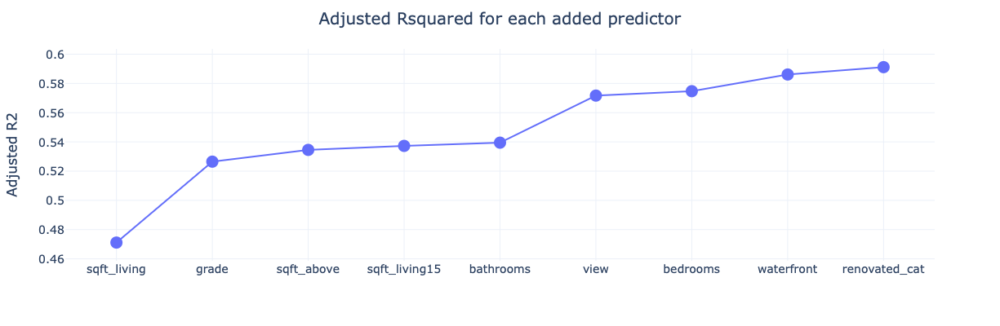

In [7]:
fig = px.line(x=candidate_preds, y=r2_adj,markers=True,
             labels={"y": "Adjusted R2","x": ""})
fig.update_layout(autosize=False,width=600,height=400,template="plotly_white",
                 title_text='Adjusted Rsquared for each added predictor', title_x=0.5,
                 font={"size":14})
fig.update_traces(marker={'size': 15})
fig.show()
fig.write_image("../figures/rsquared_adj.png",scale=5)


### Export residual plots for all predictors

In [8]:
for pred in candidate_preds:
    fname = "../figures/" + pred + ".png"
    fig = plt.figure(figsize=(12,8))
    fig = sm.graphics.plot_regress_exog(final_mdl, pred, fig=fig)
    plt.savefig(fname,format="png",dpi=300)
    plt.close()

eval_env: 1
eval_env: 1
eval_env: 1
eval_env: 1
eval_env: 1
eval_env: 1
eval_env: 1
eval_env: 1
eval_env: 1


In [9]:
final_mdl.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  price   R-squared:                       0.591
Model:                            OLS   Adj. R-squared:                  0.591
Method:                 Least Squares   F-statistic:                     3449.
Date:                Fri, 17 Dec 2021   Prob (F-statistic):               0.00
Time:                        08:56:11   Log-Likelihood:            -2.9395e+05
No. Observations:               21461   AIC:                         5.879e+05
Df Residuals:                   21451   BIC:                         5.880e+05
Df Model:                           9                                         
Covariance Type:            nonrobust                                         
=================================================================================
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
Intercept     -5.198e+05   1.35e+04    -38.568      0.000   -5.46e+05   -4.93e+05
sqft_living     195.4469      4.383     44.594      0.000     186.856     204.037
grade          1.044e+05   2198.920     47.489      0.000       1e+05    1.09e+05
sqft_above      -53.9644      4.012    -13.450      0.000     -61.828     -46.100
sqft_living15    26.1132      3.616      7.221      0.000      19.025      33.201
bathrooms     -2.143e+04   3068.868     -6.983      0.000   -2.74e+04   -1.54e+04
view           6.115e+04   2241.233     27.284      0.000    5.68e+04    6.55e+04
bedrooms       -2.41e+04   2136.439    -11.282      0.000   -2.83e+04   -1.99e+04
waterfront     4.776e+05      2e+04     23.868      0.000    4.38e+05    5.17e+05
renovated_cat  1.325e+05   8133.747     16.289      0.000    1.17e+05    1.48e+05
==============================================================================
Omnibus:                     9429.915   Durbin-Watson:                   1.978
Prob(Omnibus):                  0.000   Jarque-Bera (JB):            98858.761
Skew:                           1.834   Prob(JB):                         0.00
Kurtosis:                      12.854   Cond. No.                     4.91e+04
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 4.91e+04. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

In [10]:
def get_coef_table(lin_reg): # https://gist.github.com/zhiyzuo/972b8b95e115c44d6805c929b7b4e2c
    ''' lin_reg is a fitted statsmodels regression model
    Return a dataframe containing coefficients, pvalues, and the confidence intervals
    '''
    err_series = lin_reg.params - lin_reg.conf_int()[0]
    coef_df = pd.DataFrame({'coef': lin_reg.params.values[1:],
                            'ci_err': err_series.values[1:],
                            'pvalue': lin_reg.pvalues.round(4).values[1:],
                            'varname': err_series.index.values[1:]
                           })
    return coef_df

get_coef_table(final_mdl)

,coef,ci_err,pvalue,varname
0,195.446881,8.590565,0.0,sqft_living
1,104425.109284,4310.047960,0.0,grade
2,-53.964390,7.864056,0.0,sqft_above
3,26.113198,7.088082,0.0,sqft_living15
4,-21429.218348,6015.209470,0.0,bathrooms
5,61149.657996,4392.984113,0.0,view
6,-24102.271748,4187.580149,0.0,bedrooms
7,477625.316928,39223.399571,0.0,waterfront
8,132488.262414,15942.751547,0.0,renovated_cat


### Predicting the prices of renovated waterfront houses

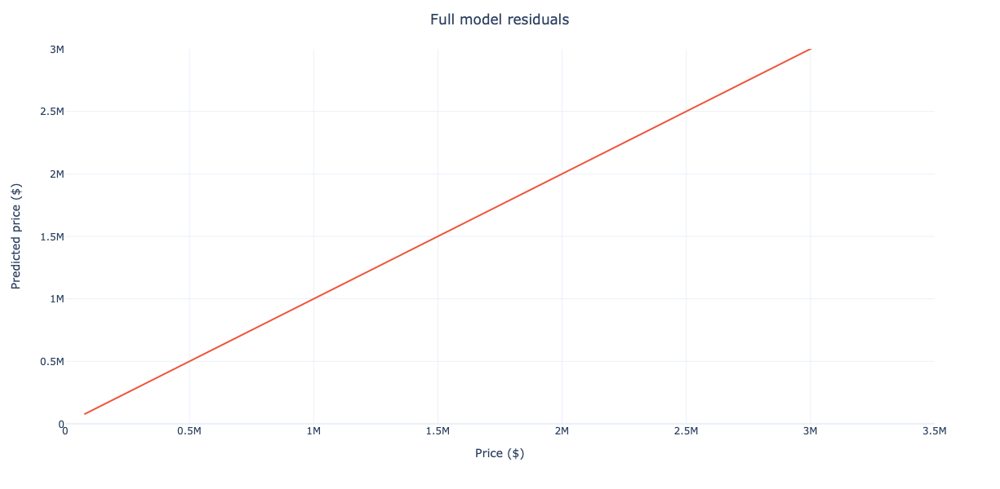

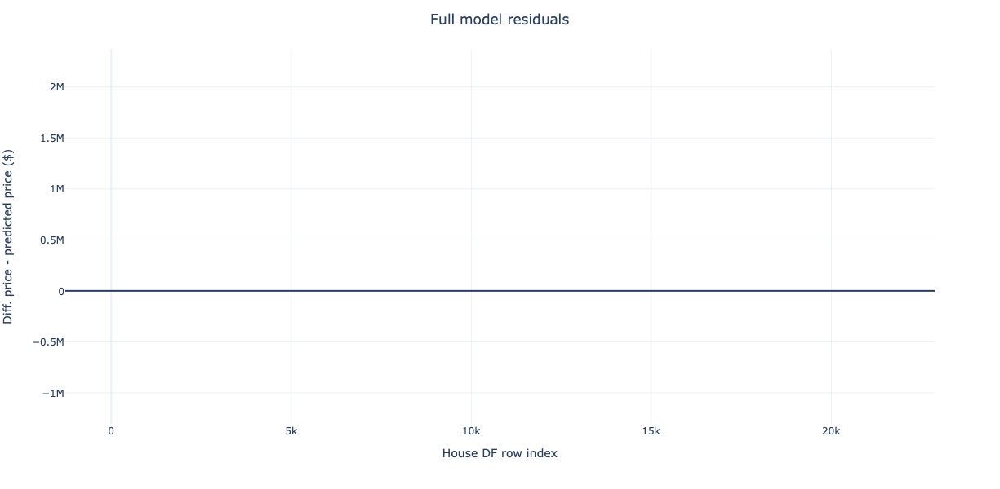

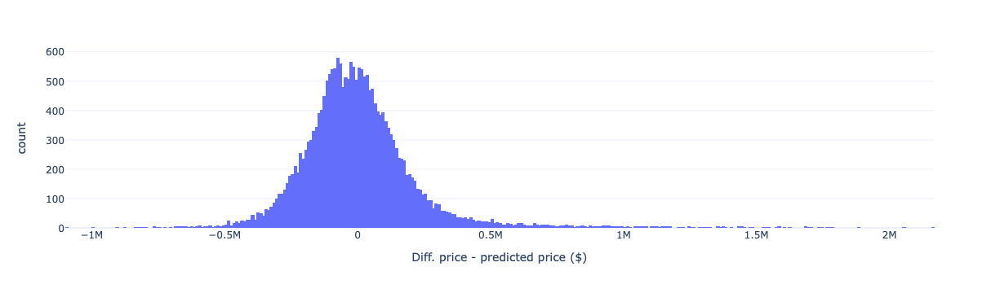

In [11]:
houses_sub["price_pred"] = final_mdl.predict(houses_sub)
houses_sub["price_res"] = houses_sub.eval("price - price_pred")

# Full model prediction
fig = px.scatter(x=houses_sub.price, y=houses_sub.price_pred,
                labels={"y": "Predicted price ($)","x": "Price ($)"})
fig.add_trace(go.Scatter(x=houses_sub.price, y=houses_sub.price, line_shape='linear'))
fig.update_traces(marker={'size': 2})
fig.update_layout(autosize=False,width=1000,height=600,template="plotly_white",
                  title="Full model residuals", title_x=0.5, showlegend=False)
fig.update_xaxes(range=(0.5,3500000)) 
fig.update_yaxes(range=(0,3000000))
fig.show()
fig.write_image("../figures/full_prediction.png",scale=5)


# Full model residuals
fig = px.scatter(x=houses_sub.index, y=houses_sub.price_res,
                labels={"y": "Diff. price - predicted price ($)","x": "House DF row index"})
fig.add_hline(y=0)
fig.update_traces(marker={'size': 2})
fig.update_layout(autosize=False,width=1000,height=600,template="plotly_white",
                  title="Full model residuals", title_x=0.5, showlegend=False)
fig.show()
fig.write_image("../figures/full_residuals.png",scale=5)


# Residuals histogram
fig = px.histogram(x=houses_sub.price_res,
                  labels={"y": "Number of houses","x": "Diff. price - predicted price ($)"})
fig.update_layout(autosize=False,width=500,height=300,template="plotly_white")
fig.show()
fig.write_image("../figures/full_residuals_hist.png",scale=5)

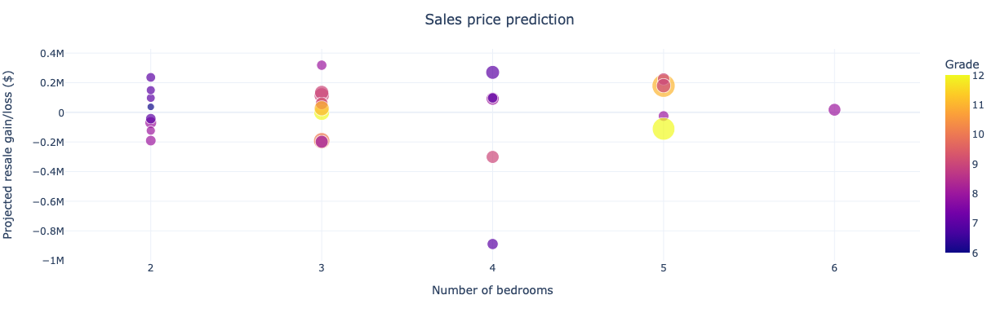

In [12]:
candidate_preds = corr[corr["price"] >= 0.3].index.tolist()
candidate_preds.append("waterfront")
candidate_preds.append("renovated_cat")
candidate_preds.append("price")
candidate_preds.append("id")
candidate_preds.append("lat")
candidate_preds.append("long")

houses_sub2 = houses[(houses.waterfront==1) & (houses.yr_renovated>0)].reset_index()
houses_sub2 = houses_sub2[candidate_preds]

houses_sub2["price_pred"] = final_mdl.predict(houses_sub2)
houses_sub2["price_gainloss"] = houses_sub.eval("price_pred-price")
houses_sub2["price_gainloss"]

fig = px.scatter(houses_sub2, x="bedrooms", y="price_gainloss", color="grade", size='sqft_living', hover_data=["id"],
                    labels={"price_gainloss": "Projected resale gain/loss ($)","bedrooms": "Number of bedrooms","grade": "Grade"})
fig.update_layout(autosize=False,width=400,height=400,template="plotly_white", title_text="Sales price prediction", title_x=0.5)
fig.update_xaxes(range=(1.5,6.5)) 
fig.show()
fig.write_image("../figures/renovated_waterfront_price_pred.png",scale=5)

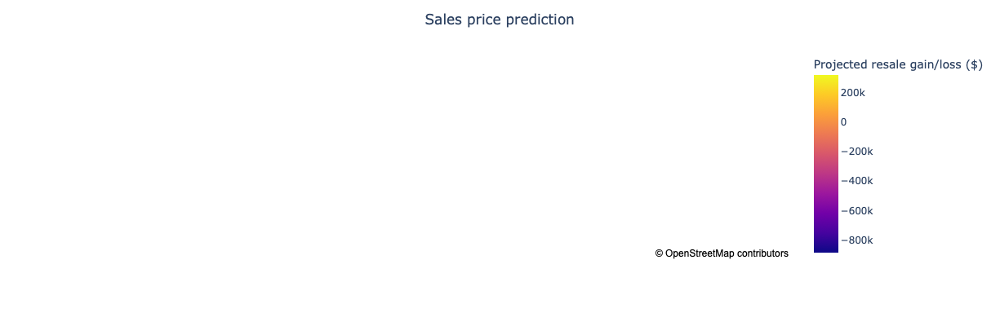

In [13]:
fig = px.scatter_mapbox(houses_sub2, lat="lat", lon="long", hover_name="id" , color="price_gainloss",
                        size="sqft_living", size_max=15,
                        #color_continuous_scale=[(0, "red"), (0.5, "green"), (1, "blue")], color_continuous_midpoint=0,
                        labels={"price_gainloss": "Projected resale gain/loss ($)"})
fig.update_layout(mapbox_style="open-street-map", title="Sales price prediction", title_x=0.5,
    autosize=False,width=600,height=400)
fig.update_geos(fitbounds="locations")
fig.show()
fig.write_image("../figures/renovated_waterfront_price_pred_MAP.png",scale=5)

In [14]:
houses_sub2

,sqft_living,grade,sqft_above,sqft_living15,bathrooms,view,bedrooms,waterfront,renovated_cat,price,id,lat,long,price_pred,price_gainloss
0,1450,7,1230,2030,1.75,4.0,2,1.0,1.0,655000.0,8096000060,47.4497,-122.375,1.250202e+06,97469.012259
1,4380,9,3720,2460,4.50,3.0,3,1.0,1.0,995000.0,7636800041,47.4734,-122.365,1.764387e+06,114456.789908
2,1008,6,1008,1132,1.50,4.0,2,1.0,1.0,480000.0,1922039062,47.3853,-122.479,1.053277e+06,37074.566165
3,5020,10,3420,3680,3.25,4.0,3,1.0,1.0,3600000.0,4114601570,47.5925,-122.287,2.129881e+06,-191605.494382
4,2120,8,2120,2870,4.50,4.0,5,1.0,1.0,1000000.0,3343301910,47.5488,-122.197,1.328246e+06,-24881.780100
5,10040,11,7680,3930,4.50,2.0,5,1.0,1.0,7060000.0,9808700762,47.6500,-122.214,2.794800e+06,179723.329643
6,3786,9,1934,2850,3.25,4.0,3,1.0,1.0,1380000.0,1269200229,47.3907,-122.448,1.842792e+06,134225.273857
7,3230,7,3230,2560,2.75,4.0,3,1.0,1.0,1150000.0,4166600115,47.3344,-122.370,1.458477e+06,NaN
8,2800,9,2800,3220,2.25,4.0,5,1.0,1.0,1850000.0,9201300050,47.5784,-122.076,1.586235e+06,225642.318544
9,3190,8,2610,2240,3.25,4.0,4,1.0,1.0,1100000.0,623059016,47.5033,-122.225,1.545369e+06,92096.611336
